<a href="https://colab.research.google.com/github/shivakerur99/Image-pro/blob/master/realisticv6model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers
!pip install xformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 29.9 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 222.5/222.5 MB 7.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 2.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 1.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 82.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 70.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 38.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 13.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 28.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 12.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━

install all packages required

unet/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


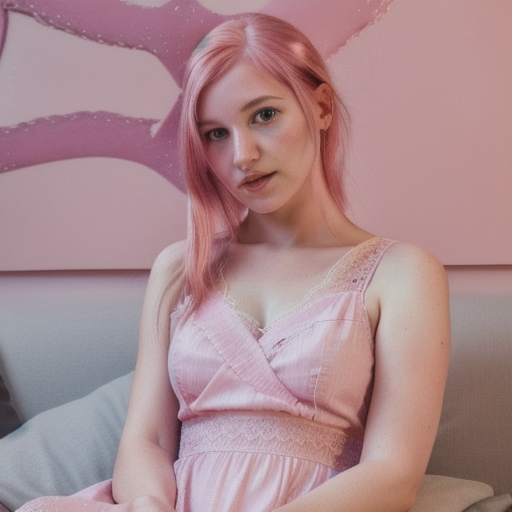

Upscaled image:


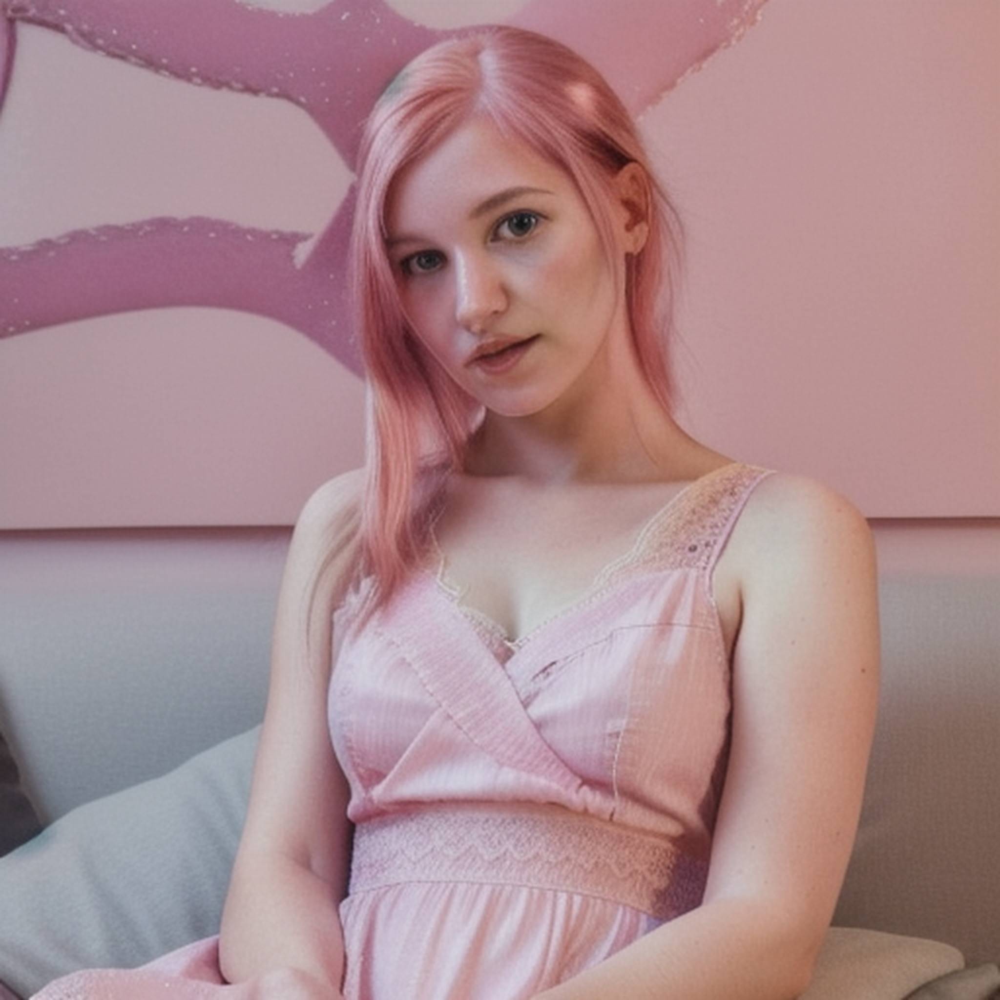

In [ ]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler
from PIL import Image
import requests
from io import BytesIO
from IPython.display import display

# Initialize Stable Diffusion Pipeline
model_id = "SG161222/Realistic_Vision_V6.0_B1_noVAE"
pipe = StableDiffusionPipeline.from_pretrained(model_id, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()

# Set the text prompt
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

you can add photo to your prompt to make your gens look more photorealistic.
Non-square aspect ratios work better for some prompts. If you want a portrait photo, try using a vertical aspect ratio. If you want a landscape photo, try using a horizontal aspect ratio.
This model was trained on 768x768px images, so use 768x768px, 640x896px, 896x640px, etc. It also works pretty good with higher resolutions such as 768x1024px or 1024x768px.

**advantages:**
1. best for 512 X 512 base image and processing time is also less and provide efficency of 93%.
2. no distortion present in 512 pixel.
3. able to understand dress based prompts effectively.
**disadvantages or limitations:**
1. less efficency in eyes

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


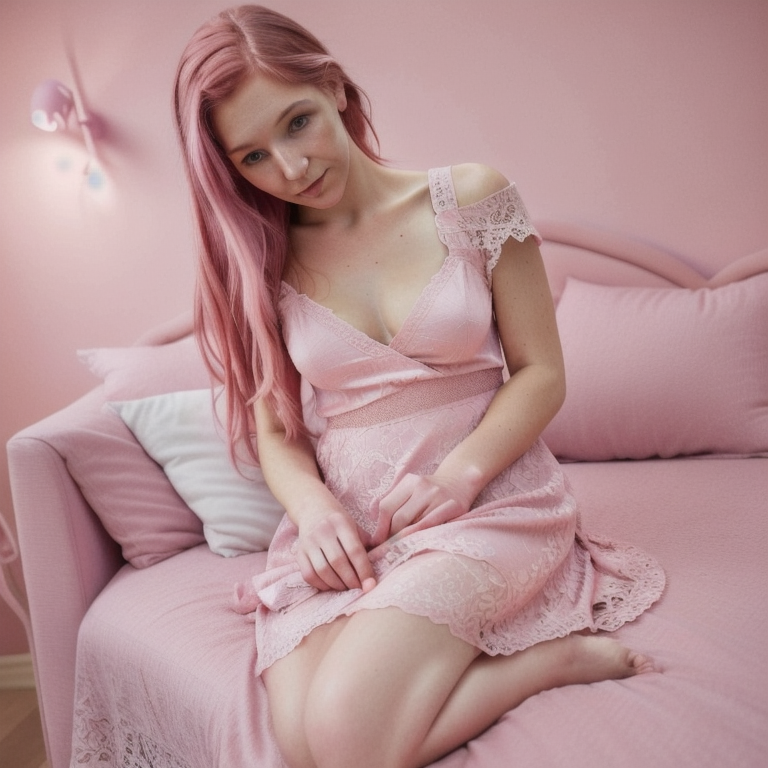

Upscaled image:


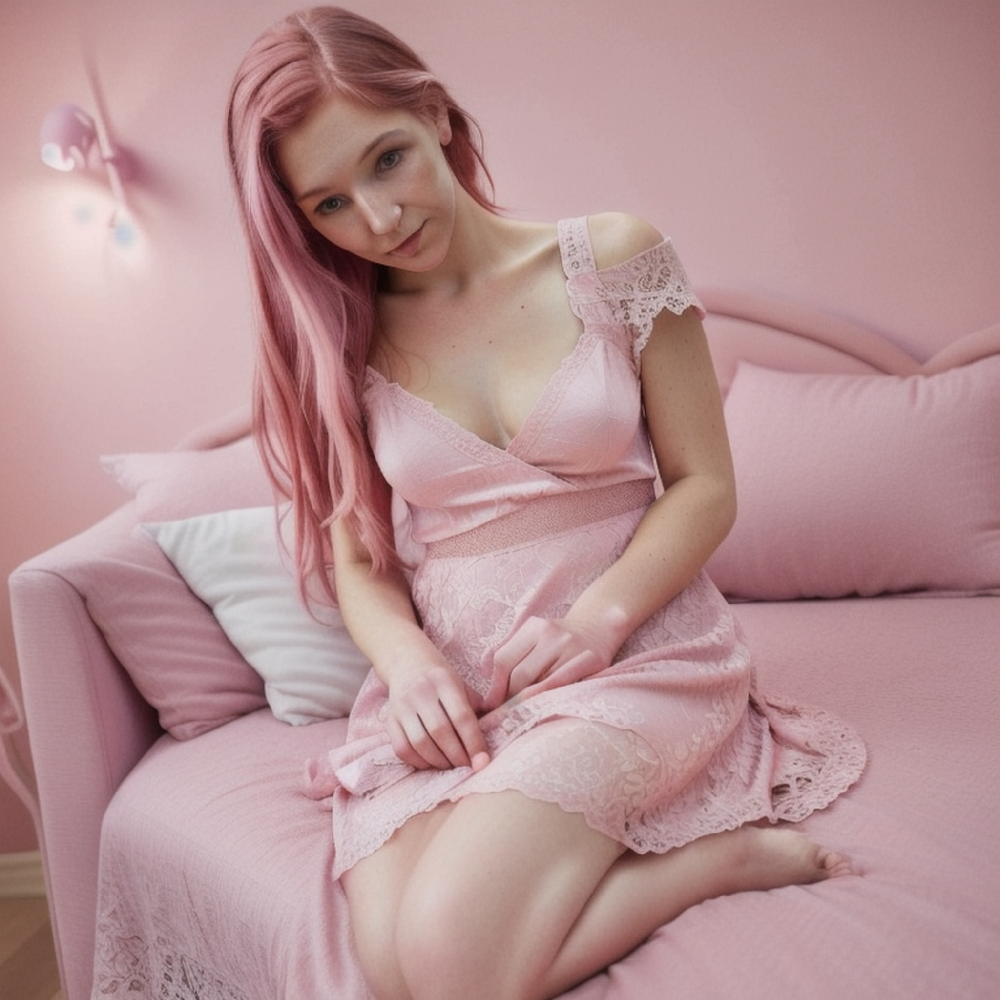

In [ ]:
# Set the text prompt
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 768
width = 768

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

you can add photo to your prompt to make your gens look more photorealistic.
Non-square aspect ratios work better for some prompts. If you want a portrait photo, try using a vertical aspect ratio. If you want a landscape photo, try using a horizontal aspect ratio.
This model was trained on 768x768px images, so use 768x768px, 640x896px, 896x640px, etc. It also works pretty good with higher resolutions such as 768x1024px or 1024x768px.

**advantages:**
1. better for 768 X 768 base image and processing time is also less and provide efficency of 90%.
2. no distortion present in 512 pixel.
3. able to understand dress based prompts effectively.
**disadvantages or limitations:**
1. less efficency in eyes

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


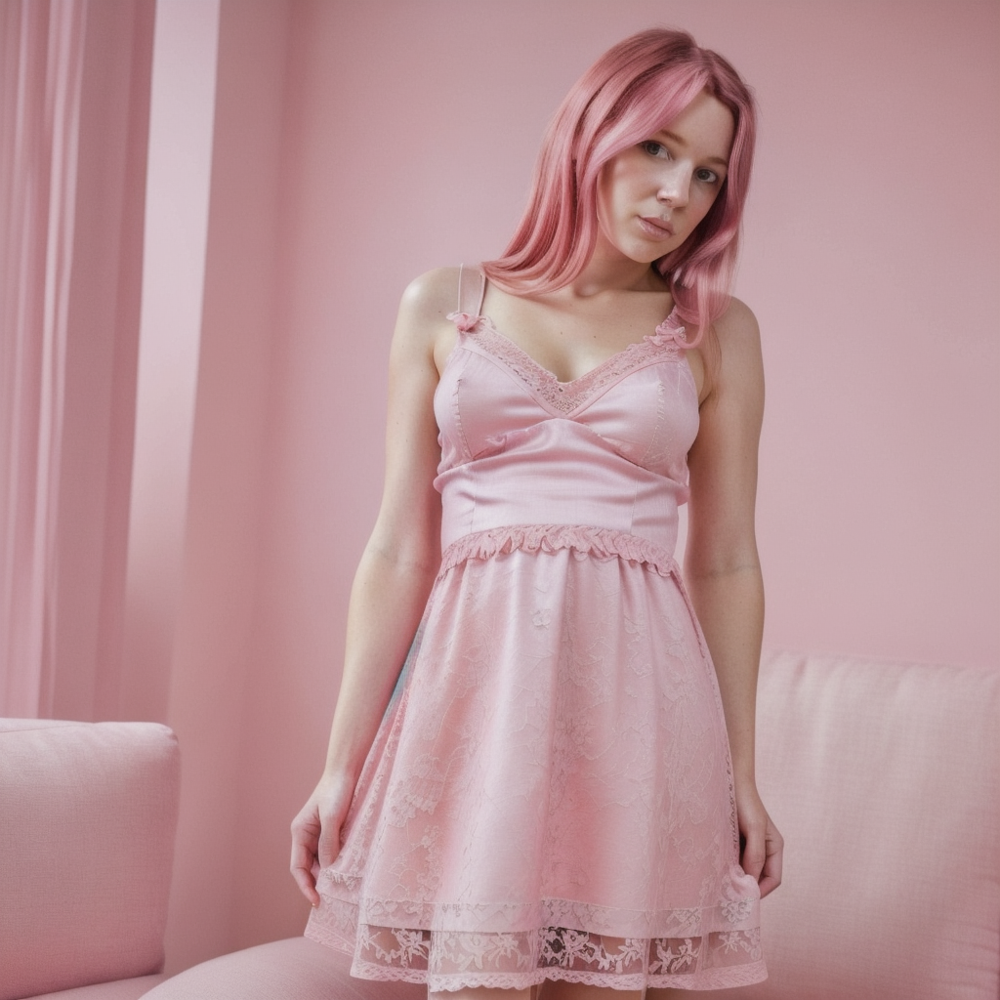

Upscaled image:


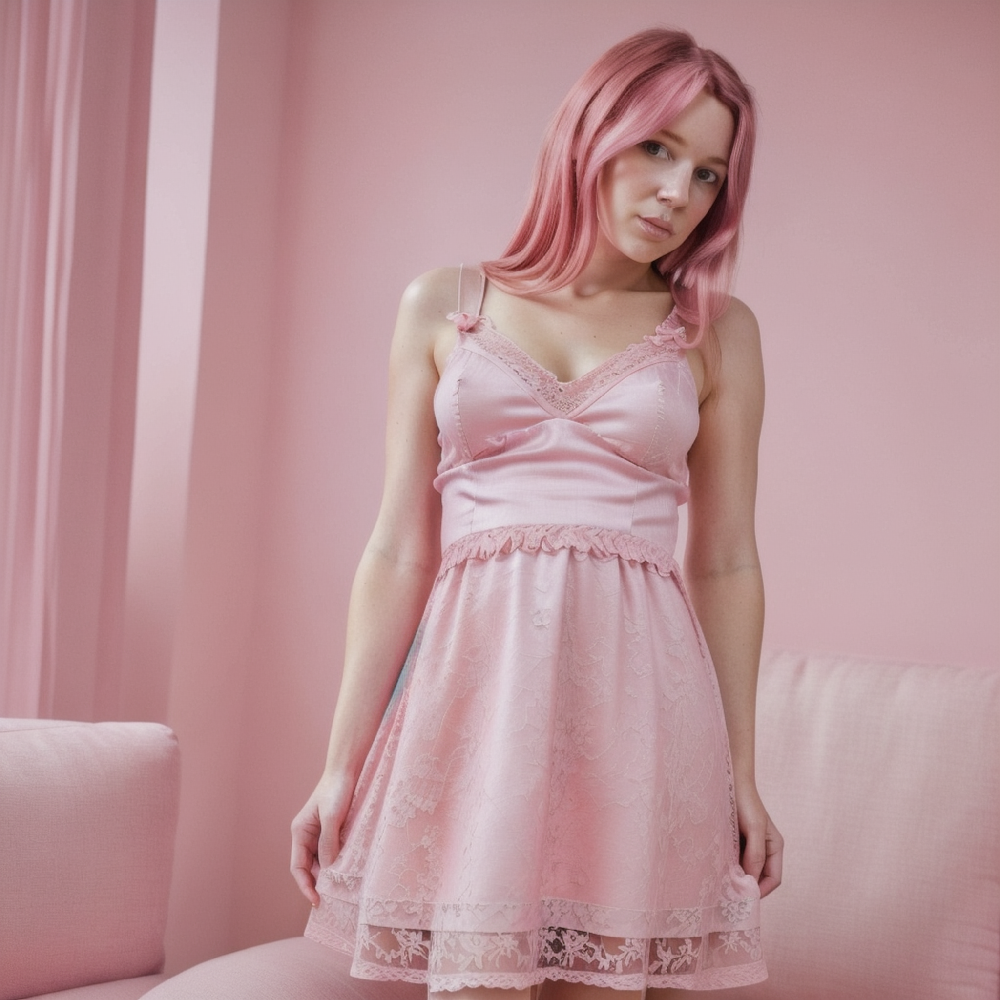

In [ ]:
# Set the text prompt
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 1024
width = 1024

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

**advantages:**
1. better than dreamart for 1024 X 1024 base image and processing time is little high than dreamartai.
2. no distortion present in 512 pixel.
3. able to understand dress based prompts effectively.
**disadvantages or limitations:**
1. less efficency in eyes

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


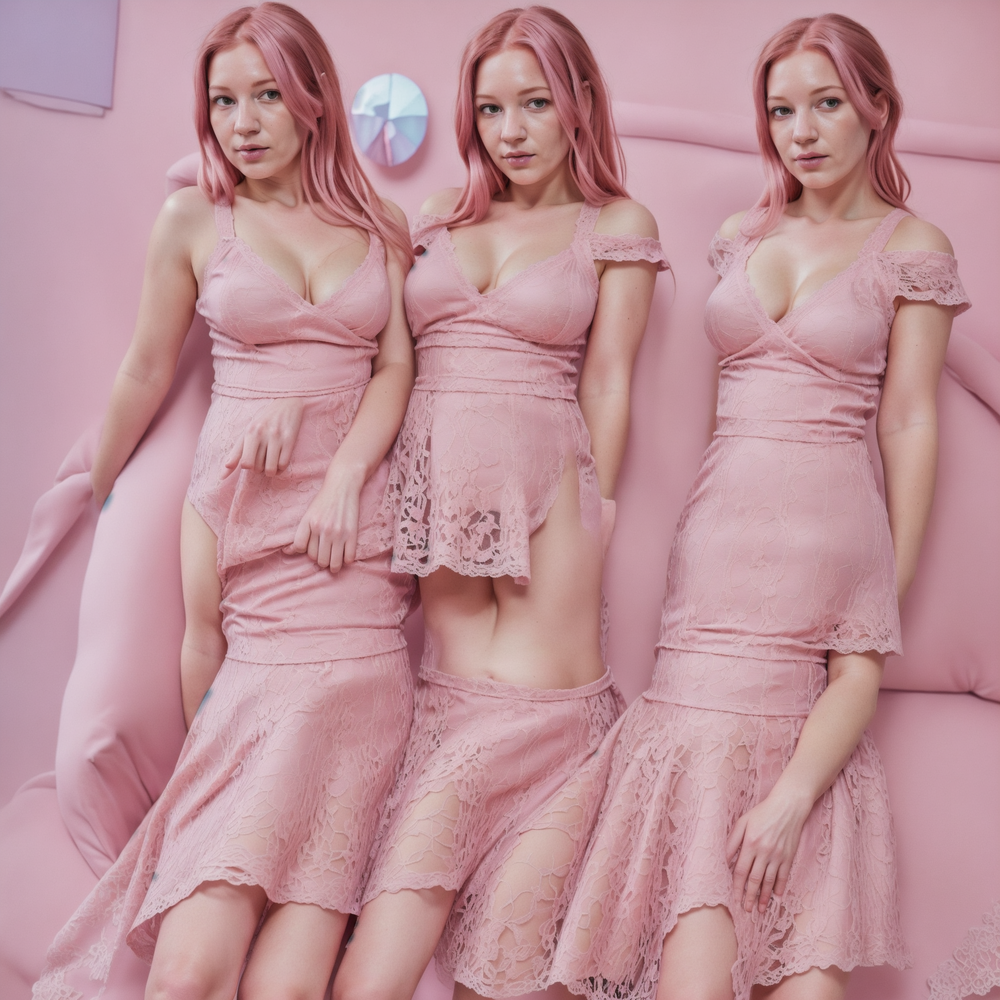

In [ ]:
# Set the text prompt
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 2048
width = 2048

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# # Display the upscaled image
# print("Upscaled image:")
# display(upscaled_images[0])



**advantages:**
1. able to create 2048 X 2048 base image
**disadvantages or limitations:**
1. less efficency in eyes
2. processing time is too high.
3. ditortion
4. multiple images of person in same image

**OTHER PROMPTS EXAMPLES**

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [': 9']


  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


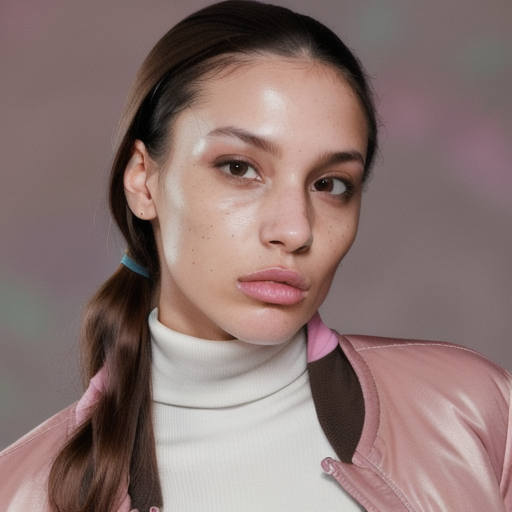

Upscaled image:


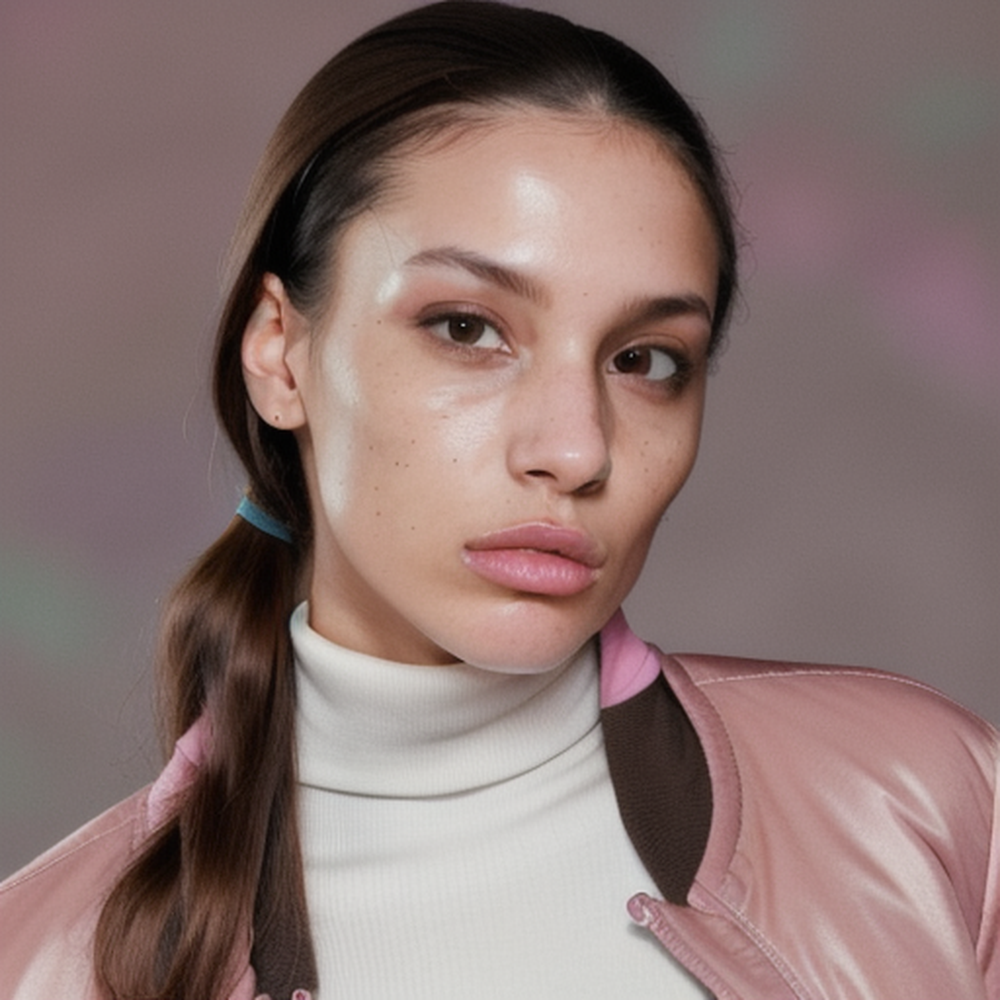

In [ ]:
prompt = "portrait of a trendy light brown skinned woman, emotive, rebellious facial features, futuristic turtle neck and jacket, iconic album cover, washed colors, studio lighting, minimal, in the style of rap, expensive fabrics, pastel studio background, fashion photoshoot, [Nikon AF-S Nikkor 85mm F/1.8G] --style raw --ar 8:9"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


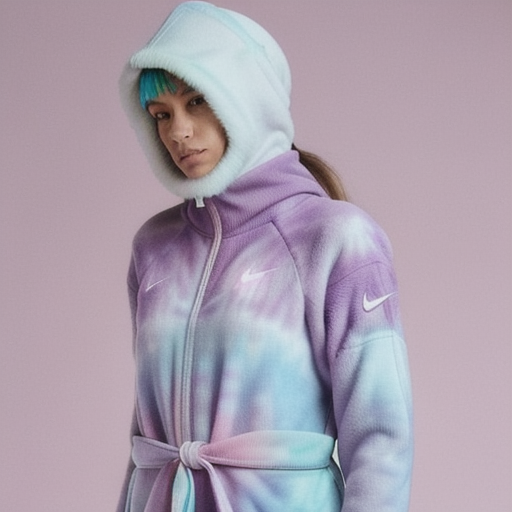

Upscaled image:


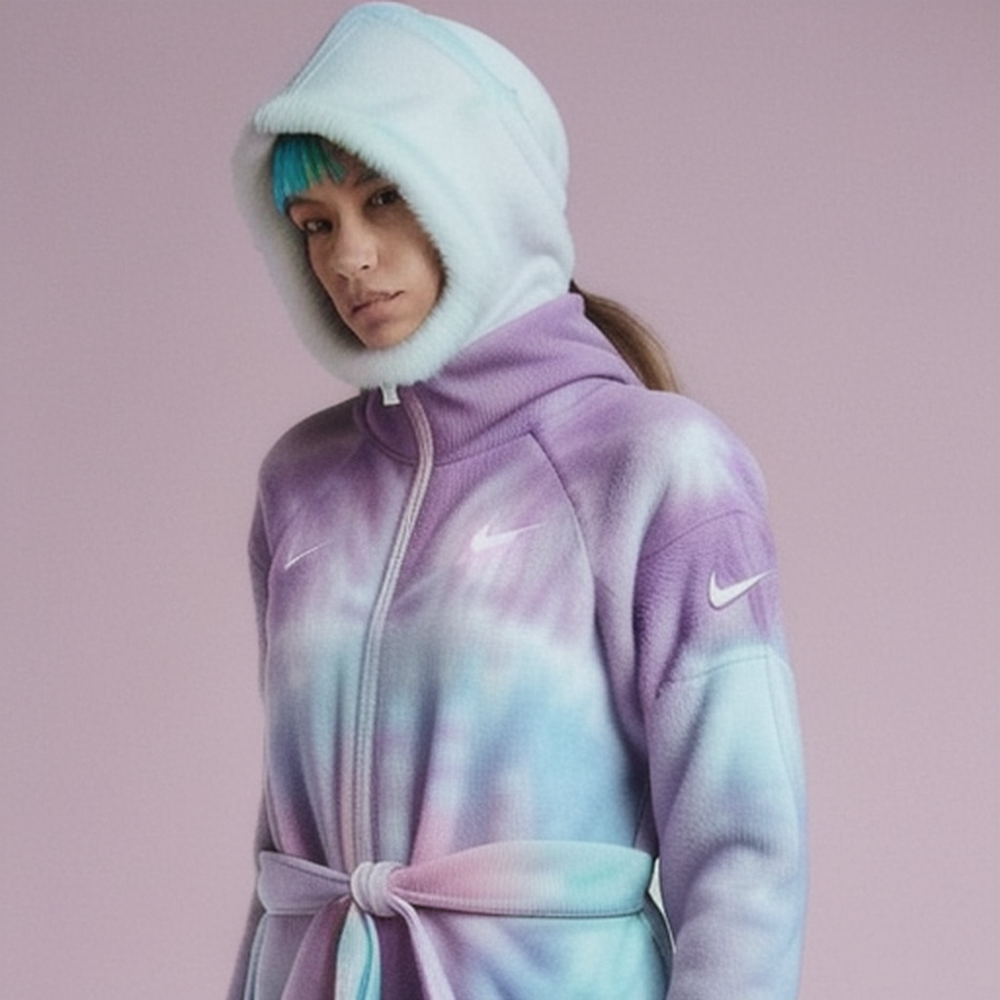

In [ ]:
# Set the text prompt
prompt = "A nike and jaquemus futuristic winter outfit collaboration, made for winter, use pastel tie dye colors, puffy and wool textures, minimal branding but unique design. provide a luxury feel through the clothing --s 750 --v 5.1"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


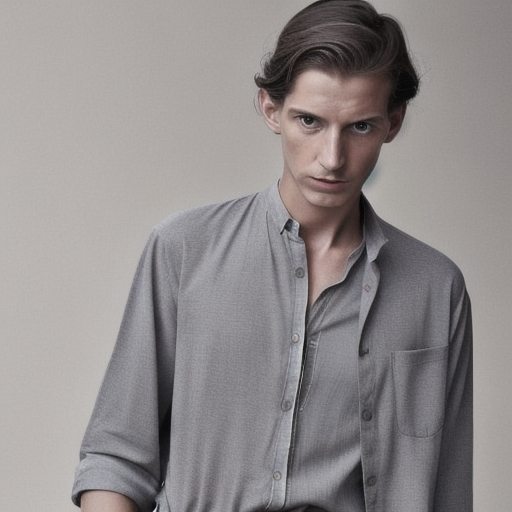

Upscaled image:


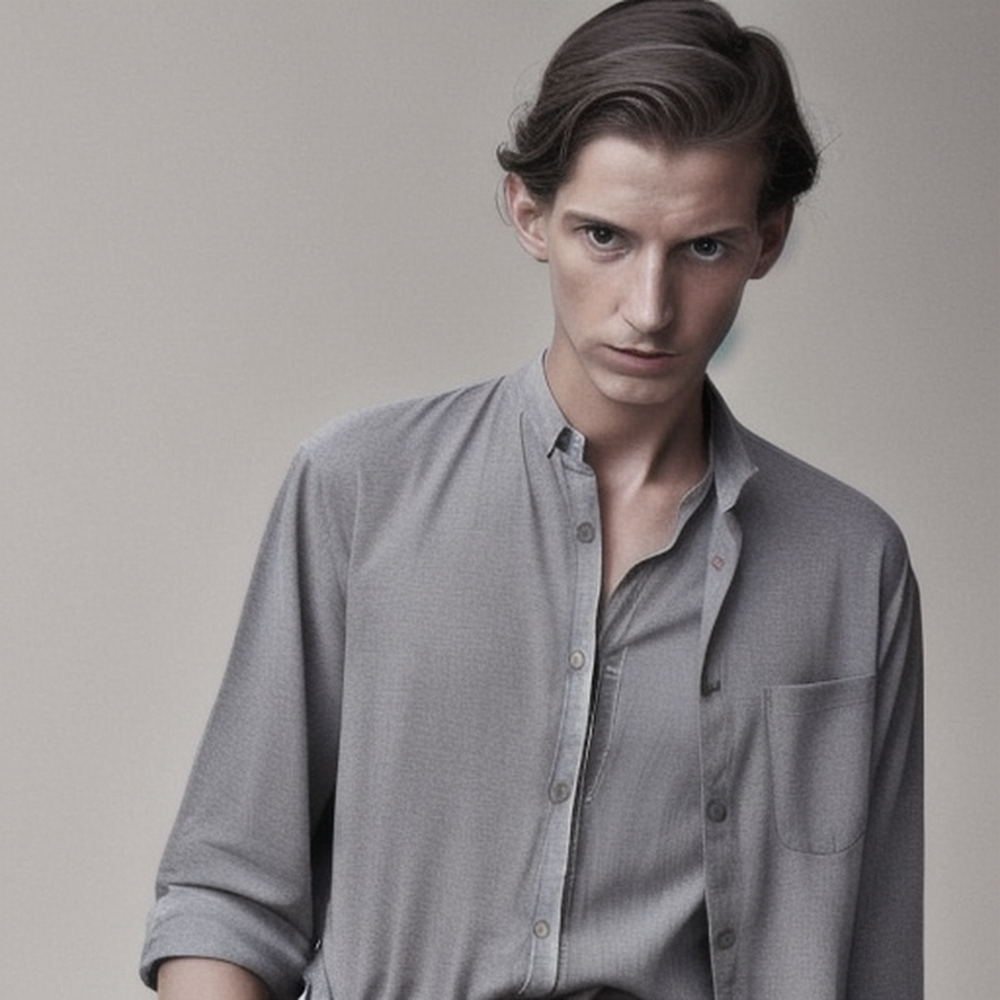

In [ ]:
# Set the text prompt
prompt = "a man dazed editorial Style, Eleven: Eleven – A Sustainable Luxury Collection, eco - friendly textile, natural and gray colors, for the New Era Consumers --ar 4:5"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


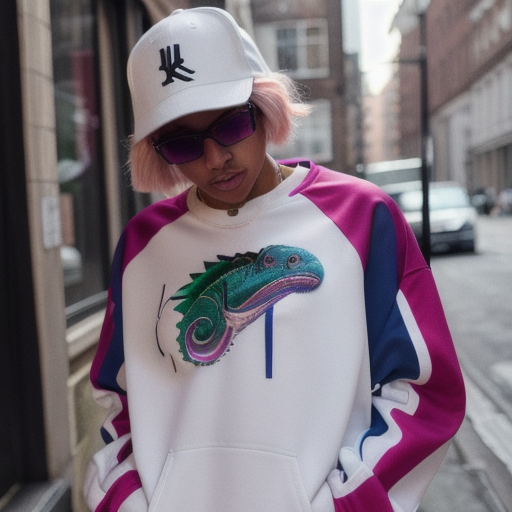

Upscaled image:


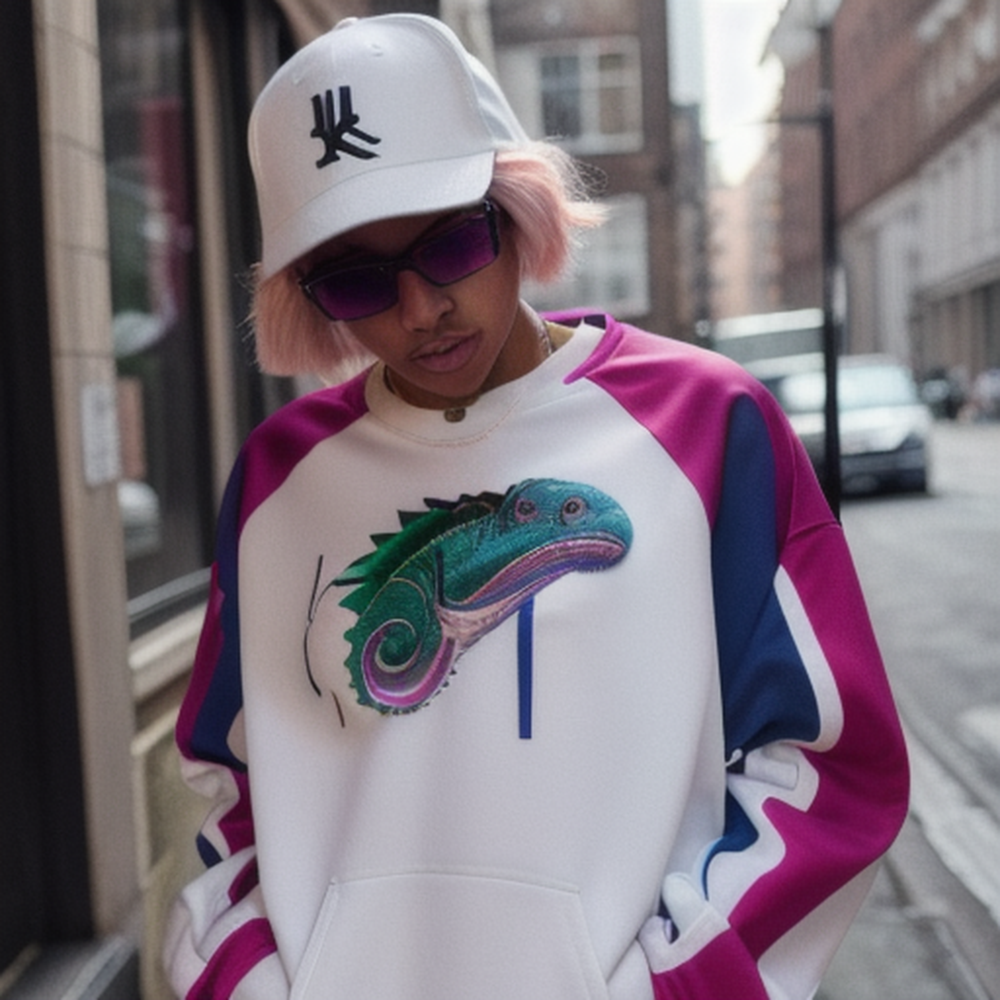

In [ ]:
# Set the text prompt
prompt = "chameleon-inspired streetwear collection by supreme and kith released in soho 2017"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

**LIMITATIONS EXAMPLES**

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mood ] -- ar 4 : 5 -- style raw -- stylize 5 0 -- v 6']


  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


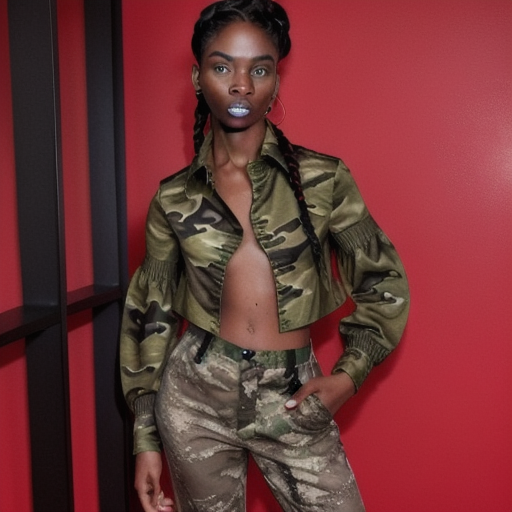

Upscaled image:


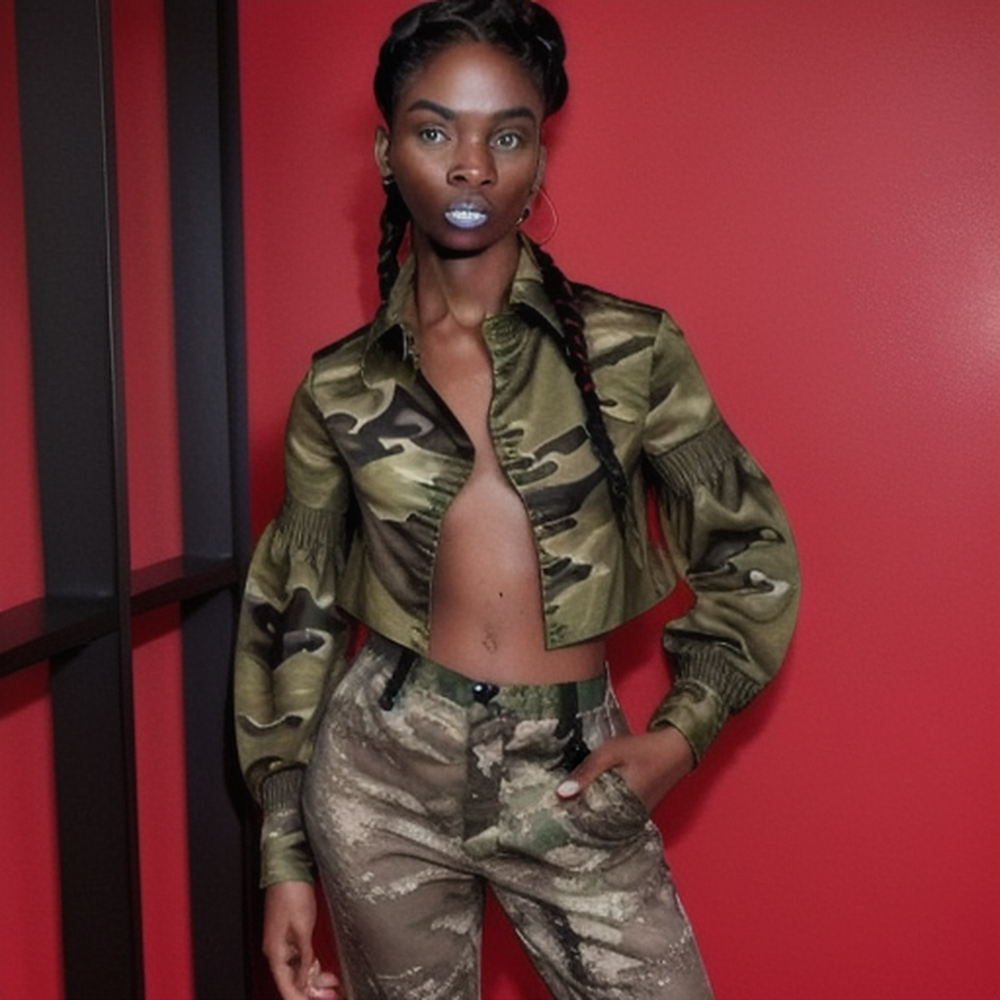

In [ ]:
# Set the text prompt
prompt = "[contemporary editorial fashion shot] + [black male, striking braided hairstyle, intense expression, medium-dark complexion] + [crimson and green camouflage military-inspired jacket, ivory ruffled shirt, crimson high-waisted wide-leg trousers, camo patent brogues] + [neutral studio background, minimal shadows] + [high-contrast lighting, powerful and avant-garde mood] --ar 4:5 --style raw --stylize 50 --v 6"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

**not able to understand facial features easily**

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


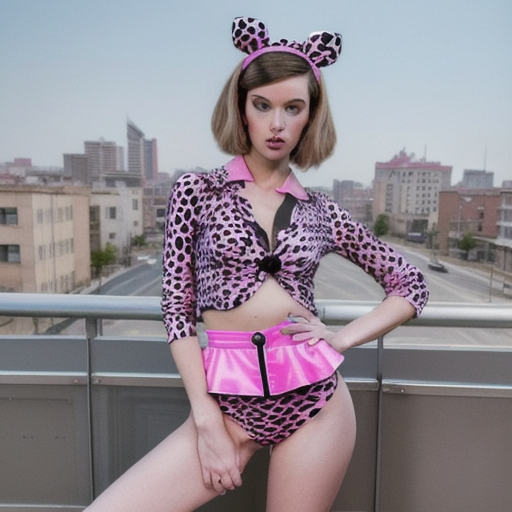

Upscaled image:


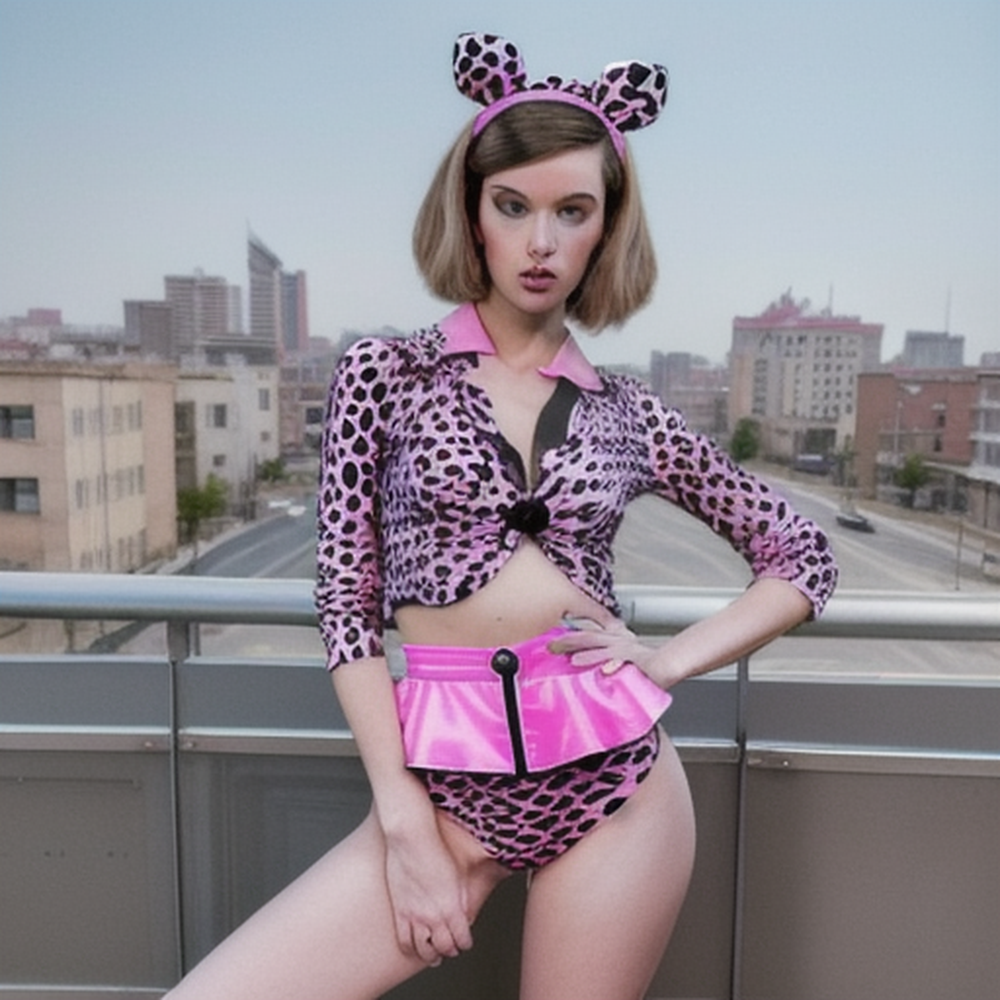

In [ ]:
# Set the text prompt
prompt = "[editorial fashion] + [hourglass waist, dynamic front-on angle, playful pose] + [whimsical outfit, animal print, avant-garde] + [urban backdrop, bright light, surreal clarity] + [pink and baby blue] --ar 4:5 --style raw --stylize 250 --v 6"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

**Frequent images which represents nudity instead of fashion (less clothes)**